# Cleaning script - move to .py file when finished

# import libraries

In [1]:
import pandas as pd
import numpy as np
import pandas_profiling as pp

# import flights data

In [2]:
flights = pd.read_csv("../data/raw_data/flights.csv")

In [3]:
flights.head()

,year,month,day,dep_time,sched_dep_time,dep_delay,arr_time,sched_arr_time,arr_delay,carrier,flight,tailnum,origin,dest,air_time,distance,hour,minute,time_hour
0,2017,10,1,27.0,2114,193.0,317.0,15,182.0,UA,1537,N54711,EWR,MIA,148.0,1085,21,14,2017-10-01T21:00:00Z
1,2017,10,1,519.0,525,-6.0,741.0,759,-18.0,UA,1161,N37287,EWR,IAH,183.0,1400,5,25,2017-10-01T05:00:00Z
2,2017,10,1,544.0,545,-1.0,815.0,819,-4.0,B6,27,N547JB,EWR,MCO,133.0,937,5,45,2017-10-01T05:00:00Z
3,2017,10,1,546.0,550,-4.0,702.0,719,-17.0,UA,761,N38446,LGA,ORD,108.0,733,5,50,2017-10-01T05:00:00Z
4,2017,10,1,552.0,600,-8.0,846.0,850,-4.0,NK,521,N675NK,EWR,FLL,156.0,1065,6,0,2017-10-01T06:00:00Z


In [4]:
# dimensions of the data set

flights.shape

(303748, 19)

In [5]:
# summary of numeric variables

flights.describe(include = 'all')

,year,month,day,dep_time,sched_dep_time,dep_delay,arr_time,sched_arr_time,arr_delay,carrier,flight,tailnum,origin,dest,air_time,distance,hour,minute,time_hour
count,303748.0,303748.000000,303748.000000,295938.000000,303748.000000,295934.000000,295600.000000,303748.000000,294896.000000,303748,303748.000000,302757,303748,303748,294896.000000,303748.000000,303748.000000,303748.000000,303748
unique,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,12,NaN,4126,3,109,NaN,NaN,NaN,NaN,6923
top,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,UA,NaN,N751EV,EWR,LAX,NaN,NaN,NaN,NaN,2017-02-09T08:00:00Z
freq,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,63406,NaN,471,115968,18044,NaN,NaN,NaN,NaN,84
mean,2017.0,6.529363,15.763758,1347.336905,1346.816568,15.187424,1472.785162,1523.343986,7.104023,NaN,1698.710668,NaN,NaN,NaN,164.489427,1154.050051,13.202415,26.575118,NaN
std,0.0,3.407936,8.775245,505.989815,478.461684,52.040383,569.419935,531.782440,55.323259,NaN,1461.222263,NaN,NaN,NaN,97.872896,760.439813,4.757648,19.569856,NaN
min,2017.0,1.000000,1.000000,1.000000,111.000000,-84.000000,1.000000,1.000000,-98.000000,NaN,1.000000,NaN,NaN,NaN,20.000000,93.000000,1.000000,0.000000,NaN
25%,2017.0,4.000000,8.000000,905.000000,910.000000,-6.000000,1052.000000,1119.000000,-20.000000,NaN,519.000000,NaN,NaN,NaN,99.000000,636.000000,9.000000,7.000000,NaN
50%,2017.0,7.000000,16.000000,1348.000000,1350.000000,-2.000000,1506.000000,1540.000000,-7.000000,NaN,1345.000000,NaN,NaN,NaN,139.000000,1005.000000,13.000000,29.000000,NaN
75%,2017.0,9.000000,23.000000,1757.000000,1745.000000,12.000000,1939.000000,1954.000000,13.000000,NaN,2238.000000,NaN,NaN,NaN,211.000000,1598.000000,17.000000,45.000000,NaN


In [6]:
# slight cheat check pandas profiling

pp.ProfileReport(flights)

Render HTML: 100%|██████████| 1/1 [00:03<00:00,  3.19s/it]


# Investigating missing data

In [7]:
flights.isna().sum()

year                 0
month                0
day                  0
dep_time          7810
sched_dep_time       0
dep_delay         7814
arr_time          8148
sched_arr_time       0
arr_delay         8852
carrier              0
flight               0
tailnum            991
origin               0
dest                 0
air_time          8852
distance             0
hour                 0
minute               0
time_hour            0
dtype: int64

# missing values in  dep_time, dep_delay, arr_time, arr_delay, tail_num and air_time.

 - investiate missing values which are not found across all four time points - assume that those with missing values for all time points are cancelled flights. Think how to deal with those. 
 - if there are some flights with information for some time points then see if can work out what is going on from the values I do have.

In [8]:
flights.loc[(np.isnan(flights.dep_delay)) & (~np.isnan(flights.dep_time))]

,year,month,day,dep_time,sched_dep_time,dep_delay,arr_time,sched_arr_time,arr_delay,carrier,flight,tailnum,origin,dest,air_time,distance,hour,minute,time_hour
119260,2017,2,25,1524.0,1524,NaN,NaN,1727,NaN,AA,1108,N3BAAA,EWR,CLT,NaN,529,15,24,2017-02-25T15:00:00Z
215679,2017,6,19,1330.0,1330,NaN,NaN,1520,NaN,AA,332,N3MGAA,LGA,ORD,NaN,733,13,30,2017-06-19T13:00:00Z
215684,2017,6,19,1340.0,1340,NaN,NaN,1554,NaN,AA,1072,N3NTAA,EWR,PHX,NaN,2133,13,40,2017-06-19T13:00:00Z
283212,2017,9,5,1630.0,1630,NaN,NaN,1820,NaN,AA,343,N3CWAA,LGA,ORD,NaN,733,16,30,2017-09-05T16:00:00Z


interesting so these four did depart and on time, but never arrived?? weird. tailnum are:
N3BAAA, N3MGAA, N3NTAA, N3CWAA. Check if they crashed??

Let's check out the same for arrival time missing data discrepancies.

In [9]:
flights.loc[(np.isnan(flights.arr_delay)) & (~np.isnan(flights.arr_time))]

,year,month,day,dep_time,sched_dep_time,dep_delay,arr_time,sched_arr_time,arr_delay,carrier,flight,tailnum,origin,dest,air_time,distance,hour,minute,time_hour
676,2017,10,1,1942.0,1800,102.0,25.0,2106,NaN,DL,1724,N3750D,EWR,SLC,NaN,1969,18,0,2017-10-01T18:00:00Z
728,2017,10,1,2037.0,2030,7.0,1215.0,2305,NaN,UA,1194,N68801,EWR,LAS,NaN,2227,20,30,2017-10-01T20:00:00Z
1382,2017,10,2,1623.0,1630,-7.0,2044.0,1843,NaN,DL,927,N333NW,LGA,MSP,NaN,1020,16,30,2017-10-02T16:00:00Z
2056,2017,10,3,1216.0,1220,-4.0,1944.0,1515,NaN,UA,1466,N420UA,EWR,AUS,NaN,1504,12,20,2017-10-03T12:00:00Z
2263,2017,10,3,1641.0,1559,42.0,2201.0,1900,NaN,AA,2238,N877AA,LGA,DFW,NaN,1389,15,59,2017-10-03T15:00:00Z
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
297424,2017,9,23,555.0,600,-5.0,1048.0,902,NaN,AA,1399,N3GYAA,LGA,MIA,NaN,1096,6,0,2017-09-23T06:00:00Z
298055,2017,9,24,621.0,623,-2.0,1335.0,859,NaN,AA,1572,N3HLAA,JFK,PHX,NaN,2153,6,23,2017-09-24T06:00:00Z
298403,2017,9,24,1355.0,1400,-5.0,1905.0,1715,NaN,UA,1978,N19117,EWR,SFO,NaN,2565,14,0,2017-09-24T14:00:00Z
298664,2017,9,24,1859.0,1900,-1.0,156.0,2155,NaN,UA,1871,N598UA,EWR,LAX,NaN,2454,19,0,2017-09-24T19:00:00Z


704 rows which I believe I can calculate the missing data for. I will need to have a read how to deal with time data.

Convert the arrival time to a datetime.

Note tried to convert these - for some reason these dates do not behave as expected.

Look at the missing data for tailnum

In [10]:
flights.loc[(flights.tailnum.isna())]

,year,month,day,dep_time,sched_dep_time,dep_delay,arr_time,sched_arr_time,arr_delay,carrier,flight,tailnum,origin,dest,air_time,distance,hour,minute,time_hour
801,2017,10,1,NaN,2110,NaN,NaN,100,NaN,UA,1071,NaN,EWR,BQN,NaN,1585,21,10,2017-10-01T21:00:00Z
802,2017,10,1,NaN,2245,NaN,NaN,52,NaN,F9,509,NaN,LGA,DEN,NaN,1620,22,45,2017-10-01T22:00:00Z
1692,2017,10,2,NaN,2110,NaN,NaN,100,NaN,UA,1071,NaN,EWR,BQN,NaN,1585,21,10,2017-10-02T21:00:00Z
2534,2017,10,3,NaN,2110,NaN,NaN,100,NaN,UA,1071,NaN,EWR,BQN,NaN,1585,21,10,2017-10-03T21:00:00Z
3389,2017,10,4,NaN,2110,NaN,NaN,100,NaN,UA,1071,NaN,EWR,BQN,NaN,1585,21,10,2017-10-04T21:00:00Z
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
301402,2017,9,27,NaN,2110,NaN,NaN,100,NaN,UA,1071,NaN,EWR,BQN,NaN,1585,21,10,2017-09-27T21:00:00Z
302275,2017,9,28,NaN,2110,NaN,NaN,100,NaN,UA,1071,NaN,EWR,BQN,NaN,1585,21,10,2017-09-28T21:00:00Z
303140,2017,9,29,NaN,2110,NaN,NaN,100,NaN,UA,1071,NaN,EWR,BQN,NaN,1585,21,10,2017-09-29T21:00:00Z
303746,2017,9,30,NaN,2109,NaN,NaN,59,NaN,UA,1071,NaN,EWR,BQN,NaN,1585,21,9,2017-09-30T21:00:00Z


doesn't look like this can be sorted out.

I will drop the missing values from the data and see how much this is.

In [11]:
# drop extra columns
flights_clean = flights.copy()
flights_clean.dropna(inplace = True)

In [12]:
flights_clean.shape

(294896, 19)

In [13]:
flights_clean.head()

,year,month,day,dep_time,sched_dep_time,dep_delay,arr_time,sched_arr_time,arr_delay,carrier,flight,tailnum,origin,dest,air_time,distance,hour,minute,time_hour
0,2017,10,1,27.0,2114,193.0,317.0,15,182.0,UA,1537,N54711,EWR,MIA,148.0,1085,21,14,2017-10-01T21:00:00Z
1,2017,10,1,519.0,525,-6.0,741.0,759,-18.0,UA,1161,N37287,EWR,IAH,183.0,1400,5,25,2017-10-01T05:00:00Z
2,2017,10,1,544.0,545,-1.0,815.0,819,-4.0,B6,27,N547JB,EWR,MCO,133.0,937,5,45,2017-10-01T05:00:00Z
3,2017,10,1,546.0,550,-4.0,702.0,719,-17.0,UA,761,N38446,LGA,ORD,108.0,733,5,50,2017-10-01T05:00:00Z
4,2017,10,1,552.0,600,-8.0,846.0,850,-4.0,NK,521,N675NK,EWR,FLL,156.0,1065,6,0,2017-10-01T06:00:00Z


In [14]:
flights_clean.isna().sum()

year              0
month             0
day               0
dep_time          0
sched_dep_time    0
dep_delay         0
arr_time          0
sched_arr_time    0
arr_delay         0
carrier           0
flight            0
tailnum           0
origin            0
dest              0
air_time          0
distance          0
hour              0
minute            0
time_hour         0
dtype: int64

# How to deal with time in this dataset

set time_hour to date time:

`flights.loc[:, 'time_hour'] = pd.to_datetime(flights.time_hour, yearfirst=True)`

In [15]:
#flights_clean.loc[:, 'time_hour'] = pd.to_datetime(flights_clean.time_hour, yearfirst=True)

#flights_clean.head()

Think about making a day of the week column for modelling purposes?
Possibly also a season column for modelling purposes.
Need a column true false for delays >15 min for modelling purposes

# Cleaning airports data

In [16]:
airports = pd.read_csv("../data/raw_data/airports.csv")

In [17]:
airports.shape

(1333, 8)

In [18]:
airports.isna().sum()

faa        0
name       0
lat        0
lon        0
alt        0
tz        56
dst       56
tzone    134
dtype: int64

Some missing data in tz, dst and tzone

In [19]:
pp.ProfileReport(airports)

Render HTML: 100%|██████████| 1/1 [00:00<00:00,  2.07it/s]


In [20]:
from timezonefinder import TimezoneFinder

tf = TimezoneFinder()

In [21]:
latitude, longitude = 52.5061, 13.358
tf.timezone_at(lng=longitude, lat=latitude)

'Europe/Berlin'

In [22]:
type(airports)
#convert lon and lat columns to numpy array

tz_array = airports[['lon','lat']].to_numpy()

In [23]:
# Patrick simple iterate through array and append
timezones = []

for lon_lat in tz_array:
    timezone = tf.timezone_at(lng=lon_lat[0], lat=lon_lat[1])
    timezones.append([timezone])

timezones

[['America/New_York'],
 ['America/Chicago'],
 ['America/Chicago'],
 ['America/New_York'],
 ['America/Chicago'],
 ['America/Chicago'],
 ['America/Chicago'],
 ['America/New_York'],
 ['America/Denver'],
 ['America/New_York'],
 ['America/Chicago'],
 ['America/New_York'],
 ['America/New_York'],
 ['America/Denver'],
 ['America/New_York'],
 ['America/Chicago'],
 ['America/Phoenix'],
 ['America/Denver'],
 ['America/New_York'],
 ['America/Chicago'],
 ['America/New_York'],
 ['America/Chicago'],
 ['America/Anchorage'],
 ['America/Denver'],
 ['America/Chicago'],
 ['America/New_York'],
 ['America/New_York'],
 ['America/Chicago'],
 ['America/Los_Angeles'],
 ['America/New_York'],
 ['America/Adak'],
 ['America/Chicago'],
 ['America/Anchorage'],
 ['America/Chicago'],
 ['America/New_York'],
 ['America/Anchorage'],
 ['America/Chicago'],
 ['America/Sitka'],
 ['America/Chicago'],
 ['America/New_York'],
 ['America/Juneau'],
 ['America/New_York'],
 ['America/New_York'],
 ['America/Chicago'],
 ['America/Denve

In [24]:
#airports['timezones'] = timezones

#airports.head()

In [25]:
# from here: https://stackoverflow.com/questions/44502344/applying-timezonefinder-function-on-a-pandas-dataframe
tf_func = tf.timezone_at

airports['timezone'] = airports.apply(lambda x: tf_func(lng=x['lon'], lat=x['lat']), axis=1)

In [26]:
airports.isna().sum()

faa           0
name          0
lat           0
lon           0
alt           0
tz           56
dst          56
tzone       134
timezone      0
dtype: int64

Now we have no missing timezones let's see if we can use this to impute the missing values in tx and dst

Check unique timezones and tzone to find out?

In [27]:
airports.tzone.unique(), airports.tzone.nunique()

(array(['America/New_York', nan, 'America/Chicago', 'America/Denver',
        'America/Phoenix', 'America/Anchorage', 'America/Los_Angeles',
        'America/Adak', 'Pacific/Honolulu', 'Australia/Sydney',
        'Europe/Budapest'], dtype=object),
 10)

In [28]:
airports.timezone.unique(), airports.timezone.nunique()

(array(['America/New_York', 'America/Chicago', 'America/Denver',
        'America/Phoenix', 'America/Anchorage', 'America/Los_Angeles',
        'America/Adak', 'America/Sitka', 'America/Juneau',
        'America/Metlakatla', 'America/Indiana/Indianapolis',
        'America/Detroit', 'America/Nome', 'Pacific/Honolulu',
        'America/Boise', 'Australia/Sydney', 'America/Menominee',
        'America/Kentucky/Louisville', 'Europe/Moscow', 'Europe/Budapest',
        'America/Yakutat'], dtype=object),
 21)

Hmm. so probably not. I will try and see if I can get rid of some. What I will do for now is remove tz (Timezone offset from GMT). This can be worked out from the timezone stamp in the flights dataset and recode any remaining missing values in dst to U (unknown).

In [29]:
# make a dictionary from existing timezone dst information
dst_lookup = pd.Series(airports.dst.values, index = airports.tzone).to_dict()

In [30]:
airports.loc[(airports.dst.isna())]

,faa,name,lat,lon,alt,tz,dst,tzone,timezone
58,ALN,St Louis Regional Airport,38.890301,-90.045998,544,NaN,NaN,NaN,America/Chicago
104,AXN,Chandler Field,45.866299,-95.394699,1425,NaN,NaN,NaN,America/Chicago
110,BBD,Curtis Field,31.179300,-99.323898,1827,NaN,NaN,NaN,America/Chicago
135,BIH,Eastern Sierra Regional Airport,37.373100,-118.363998,4124,NaN,NaN,NaN,America/Los_Angeles
144,BKE,Baker City Municipal Airport,44.837299,-117.808998,3373,NaN,NaN,NaN,America/Los_Angeles
163,BPI,Miley Memorial Field,42.585098,-110.111000,6990,NaN,NaN,NaN,America/Denver
172,BTL,W K Kellogg Airport,42.307301,-85.251503,952,NaN,NaN,NaN,America/Detroit
185,BYI,Burley Municipal Airport,42.542599,-113.772003,4150,NaN,NaN,NaN,America/Boise
199,CCY,Northeast Iowa Regional Airport,43.072601,-92.610802,1125,NaN,NaN,NaN,America/Chicago
236,CLU,Columbus Municipal Airport,39.261902,-85.896301,656,NaN,NaN,NaN,America/Indiana/Indianapolis


Ok I will remove tz, dst, tzone

In [31]:
airports_clean = airports.drop(columns = ['tz', 'dst', 'tzone']).copy()

In [32]:
airports_clean.head()

,faa,name,lat,lon,alt,timezone
0,0V4,Brookneal/Campbell County Airport,37.141701,-79.016403,596,America/New_York
1,19S,Sublette Municipal Airport,37.491402,-100.830002,2908,America/Chicago
2,23M,Clarke County Airport,32.084900,-88.738899,320,America/Chicago
3,2A5,Causey Airport,35.911800,-79.617599,723,America/New_York
4,2H0,Shelby County Airport,39.410400,-88.845398,618,America/Chicago


worth changing timezones to datetime timezone object type now? Probably. This will give the dst and tz column info all in one timezone column.

In [33]:
# change timezone to datetime object
import pytz
pacific = pytz.timezone('US/Pacific')

airports_clean['timezone'] = airports_clean.apply(lambda x: pytz.timezone(x['timezone']), axis=1)

In [34]:
airports_clean.head()

,faa,name,lat,lon,alt,timezone
0,0V4,Brookneal/Campbell County Airport,37.141701,-79.016403,596,America/New_York
1,19S,Sublette Municipal Airport,37.491402,-100.830002,2908,America/Chicago
2,23M,Clarke County Airport,32.084900,-88.738899,320,America/Chicago
3,2A5,Causey Airport,35.911800,-79.617599,723,America/New_York
4,2H0,Shelby County Airport,39.410400,-88.845398,618,America/Chicago


In [35]:
airports_clean.isna().sum()

faa         0
name        0
lat         0
lon         0
alt         0
timezone    0
dtype: int64

Airports is now clean - move to the next dataset - weather is the next biggest.

# Weather

In [36]:
weather = pd.read_csv('../data/raw_data/weather.csv')

In [37]:
weather.shape

(26201, 15)

In [38]:
weather.describe(include = 'all')

,origin,year,month,day,hour,temp,dewp,humid,wind_dir,wind_speed,wind_gust,precip,pressure,visib,time_hour
count,26201,26201.0,26201.000000,26201.000000,26201.000000,559.000000,559.000000,559.000000,23540.000000,23554.000000,23554.000000,1370.000000,433.000000,26190.000000,26201
unique,3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8735
top,EWR,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2017-07-25T02:00:00Z
freq,8735,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3
mean,NaN,2017.0,6.511469,15.678753,11.500897,60.621288,46.347585,64.006118,183.802889,9.615703,11.065559,0.017000,1016.105081,9.345643,NaN
std,NaN,0.0,3.440691,8.772652,6.921799,12.786407,16.170313,23.677199,109.649319,4.675760,5.380772,0.031604,6.867952,1.919649,NaN
min,NaN,2017.0,1.000000,1.000000,0.000000,26.100000,7.000000,11.760000,0.000000,0.000000,0.000000,0.000000,915.900000,0.120000,NaN
25%,NaN,2017.0,4.000000,8.000000,6.000000,50.550000,36.000000,44.330000,80.000000,6.904680,7.945768,0.000000,1013.600000,10.000000,NaN
50%,NaN,2017.0,7.000000,16.000000,12.000000,63.000000,48.900000,64.370000,200.000000,9.206240,10.594357,0.010000,1015.900000,10.000000,NaN
75%,NaN,2017.0,10.000000,23.000000,17.000000,71.100000,57.900000,84.725000,270.000000,12.658580,14.567241,0.020000,1017.800000,10.000000,NaN


In [39]:
pp.ProfileReport(weather)

Render HTML: 100%|██████████| 1/1 [00:02<00:00,  2.87s/it]


Hmm possibly there is something going on with temperature - possibly only taken a few times a day rather than every hour? check this. 559 temp and dewp (both in fareignheit - convert to Celcuis, keep F for US)

In [40]:
weather.loc[(~weather.temp.isna())]

,origin,year,month,day,hour,temp,dewp,humid,wind_dir,wind_speed,wind_gust,precip,pressure,visib,time_hour
482,EWR,2017,1,21,2,42.1,39.9,91.84,0.0,0.000000,0.000000,0.00,NaN,5.0,2017-01-21T10:00:00Z
500,EWR,2017,1,21,20,46.9,44.1,89.92,240.0,8.055460,9.270062,0.00,1009.6,8.0,2017-01-22T04:00:00Z
501,EWR,2017,1,21,21,46.9,44.1,89.92,220.0,6.904680,7.945768,0.00,1009.6,7.0,2017-01-22T05:00:00Z
502,EWR,2017,1,21,22,46.0,44.1,93.03,230.0,6.904680,7.945768,0.00,1009.5,6.0,2017-01-22T06:00:00Z
503,EWR,2017,1,21,23,46.9,45.0,93.06,220.0,5.753900,6.621473,0.00,1009.6,6.0,2017-01-22T07:00:00Z
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25272,LGA,2017,11,22,7,52.0,43.0,71.28,160.0,5.753900,6.621473,0.00,1014.7,10.0,2017-11-22T15:00:00Z
25273,LGA,2017,11,22,8,52.0,43.0,71.28,150.0,6.709047,7.720638,0.00,1013.9,10.0,2017-11-22T16:00:00Z
25655,LGA,2017,12,8,6,39.9,24.1,52.88,260.0,11.507800,13.242946,0.00,1017.1,10.0,2017-12-08T14:00:00Z
25691,LGA,2017,12,9,18,32.0,30.0,92.22,360.0,6.904680,7.945768,0.01,NaN,1.0,2017-12-10T02:00:00Z


In [41]:
ewr_weather = weather.loc[weather.origin == 'EWR']

ewr_weather.head()

,origin,year,month,day,hour,temp,dewp,humid,wind_dir,wind_speed,wind_gust,precip,pressure,visib,time_hour
0,EWR,2017,1,1,0,NaN,NaN,NaN,200.0,17.26170,19.864419,NaN,NaN,10.0,2017-01-01T08:00:00Z
1,EWR,2017,1,1,1,NaN,NaN,NaN,220.0,16.11092,18.540125,NaN,NaN,10.0,2017-01-01T09:00:00Z
2,EWR,2017,1,1,2,NaN,NaN,NaN,190.0,11.50780,13.242946,NaN,NaN,10.0,2017-01-01T10:00:00Z
3,EWR,2017,1,1,3,NaN,NaN,NaN,190.0,8.05546,9.270062,NaN,NaN,10.0,2017-01-01T11:00:00Z
4,EWR,2017,1,1,4,NaN,NaN,NaN,220.0,9.20624,10.594357,NaN,NaN,10.0,2017-01-01T12:00:00Z


In [42]:
ewr_weather_no_temp_nan = ewr_weather.dropna(subset = ['temp']).copy()
ewr_weather_no_temp_nan.head()

,origin,year,month,day,hour,temp,dewp,humid,wind_dir,wind_speed,wind_gust,precip,pressure,visib,time_hour
482,EWR,2017,1,21,2,42.1,39.9,91.84,0.0,0.00000,0.000000,0.0,NaN,5.0,2017-01-21T10:00:00Z
500,EWR,2017,1,21,20,46.9,44.1,89.92,240.0,8.05546,9.270062,0.0,1009.6,8.0,2017-01-22T04:00:00Z
501,EWR,2017,1,21,21,46.9,44.1,89.92,220.0,6.90468,7.945768,0.0,1009.6,7.0,2017-01-22T05:00:00Z
502,EWR,2017,1,21,22,46.0,44.1,93.03,230.0,6.90468,7.945768,0.0,1009.5,6.0,2017-01-22T06:00:00Z
503,EWR,2017,1,21,23,46.9,45.0,93.06,220.0,5.75390,6.621473,0.0,1009.6,6.0,2017-01-22T07:00:00Z


In [43]:
ewr_weather_no_temp_nan.nunique

<bound method DataFrame.nunique of      origin  year  month  day  hour  temp  dewp  humid  wind_dir  wind_speed  \
482     EWR  2017      1   21     2  42.1  39.9  91.84       0.0     0.00000   
500     EWR  2017      1   21    20  46.9  44.1  89.92     240.0     8.05546   
501     EWR  2017      1   21    21  46.9  44.1  89.92     220.0     6.90468   
502     EWR  2017      1   21    22  46.0  44.1  93.03     230.0     6.90468   
503     EWR  2017      1   21    23  46.9  45.0  93.06     220.0     5.75390   
...     ...   ...    ...  ...   ...   ...   ...    ...       ...         ...   
6617    EWR  2017     10    3    18  69.1  48.0  46.92       NaN     5.75390   
6882    EWR  2017     10   14    19  72.0  63.0  73.31       0.0     0.00000   
7246    EWR  2017     10   29    23  66.0  64.0  93.26     110.0    14.96014   
7427    EWR  2017     11    6    12  63.0  60.1  90.25     210.0    12.65858   
8234    EWR  2017     12   10     3  32.0  28.9  88.17     320.0    12.65858   

    

In [44]:
extra_weather = pd.read_csv('../data/raw_data/extra_weather.csv')

In [45]:
extra_weather.describe()

,temp_max,temp_min,temp_ave,temp_departure,hdd,ccd
count,1095.000000,1095.000000,1095.000000,1095.000000,1095.000000,1095.000000
mean,64.073973,49.403653,56.738813,1.103836,11.600913,3.588128
std,17.759644,16.244914,16.768351,7.893080,12.912326,5.591621
min,19.000000,9.000000,14.000000,-21.500000,0.000000,0.000000
25%,50.000000,37.000000,43.500000,-3.800000,0.000000,0.000000
50%,66.000000,50.000000,57.500000,0.500000,7.000000,0.000000
75%,80.000000,64.500000,71.500000,5.750000,21.000000,7.000000
max,101.000000,80.000000,90.500000,26.400000,51.000000,26.000000


In [46]:
extra_weather.head()

,date,temp_max,temp_min,temp_ave,temp_departure,hdd,ccd,ppt,new_snow,snow_depth,airport
0,2017-01-01,50,33,41.5,7.2,23,0,T,0,0,EWR
1,2017-01-02,42,32,37.0,2.9,28,0,0.29,T,0,EWR
2,2017-01-03,44,39,41.5,7.6,23,0,0.43,0,0,EWR
3,2017-01-04,54,33,43.5,9.8,21,0,T,0,0,EWR
4,2017-01-05,33,26,29.5,-4.1,35,0,T,T,0,EWR


In [47]:
extra_weather.isna().sum()

date              0
temp_max          0
temp_min          0
temp_ave          0
temp_departure    0
hdd               0
ccd               0
ppt               0
new_snow          0
snow_depth        0
airport           0
dtype: int64

In [48]:
# drop unnecessary columns
extra_weather.drop(columns = ['hdd', 'ccd'], inplace = True)

extra_weather.head()

,date,temp_max,temp_min,temp_ave,temp_departure,ppt,new_snow,snow_depth,airport
0,2017-01-01,50,33,41.5,7.2,T,0,0,EWR
1,2017-01-02,42,32,37.0,2.9,0.29,T,0,EWR
2,2017-01-03,44,39,41.5,7.6,0.43,0,0,EWR
3,2017-01-04,54,33,43.5,9.8,T,0,0,EWR
4,2017-01-05,33,26,29.5,-4.1,T,T,0,EWR


In [49]:
#rename airport to origin to help joining

extra_weather.rename(columns = {'airport':'origin'}, inplace = True)

extra_weather['join_id'] = extra_weather['date'] + '-' + extra_weather['origin']
extra_weather.drop(columns = ['date', 'origin'], inplace = True)

extra_weather.head()

,temp_max,temp_min,temp_ave,temp_departure,ppt,new_snow,snow_depth,join_id
0,50,33,41.5,7.2,T,0,0,2017-01-01-EWR
1,42,32,37.0,2.9,0.29,T,0,2017-01-02-EWR
2,44,39,41.5,7.6,0.43,0,0,2017-01-03-EWR
3,54,33,43.5,9.8,T,0,0,2017-01-04-EWR
4,33,26,29.5,-4.1,T,T,0,2017-01-05-EWR


In [50]:
weather.head()

,origin,year,month,day,hour,temp,dewp,humid,wind_dir,wind_speed,wind_gust,precip,pressure,visib,time_hour
0,EWR,2017,1,1,0,NaN,NaN,NaN,200.0,17.26170,19.864419,NaN,NaN,10.0,2017-01-01T08:00:00Z
1,EWR,2017,1,1,1,NaN,NaN,NaN,220.0,16.11092,18.540125,NaN,NaN,10.0,2017-01-01T09:00:00Z
2,EWR,2017,1,1,2,NaN,NaN,NaN,190.0,11.50780,13.242946,NaN,NaN,10.0,2017-01-01T10:00:00Z
3,EWR,2017,1,1,3,NaN,NaN,NaN,190.0,8.05546,9.270062,NaN,NaN,10.0,2017-01-01T11:00:00Z
4,EWR,2017,1,1,4,NaN,NaN,NaN,220.0,9.20624,10.594357,NaN,NaN,10.0,2017-01-01T12:00:00Z


In [51]:
# format day and month
weather['day_str'] = weather['day'].astype(str).str.zfill(2)
weather['month_str'] = weather['month'].astype(str).str.zfill(2)

weather['date'] = weather['year'].astype(str) + '-' + weather['month_str'] + '-' + weather['day_str']

weather['join_id'] = weather['date'] + '-' + weather['origin']

In [52]:
weather.drop(columns = ['day_str', 'month_str'], inplace = True)

weather.head()

,origin,year,month,day,hour,temp,dewp,humid,wind_dir,wind_speed,wind_gust,precip,pressure,visib,time_hour,date,join_id
0,EWR,2017,1,1,0,NaN,NaN,NaN,200.0,17.26170,19.864419,NaN,NaN,10.0,2017-01-01T08:00:00Z,2017-01-01,2017-01-01-EWR
1,EWR,2017,1,1,1,NaN,NaN,NaN,220.0,16.11092,18.540125,NaN,NaN,10.0,2017-01-01T09:00:00Z,2017-01-01,2017-01-01-EWR
2,EWR,2017,1,1,2,NaN,NaN,NaN,190.0,11.50780,13.242946,NaN,NaN,10.0,2017-01-01T10:00:00Z,2017-01-01,2017-01-01-EWR
3,EWR,2017,1,1,3,NaN,NaN,NaN,190.0,8.05546,9.270062,NaN,NaN,10.0,2017-01-01T11:00:00Z,2017-01-01,2017-01-01-EWR
4,EWR,2017,1,1,4,NaN,NaN,NaN,220.0,9.20624,10.594357,NaN,NaN,10.0,2017-01-01T12:00:00Z,2017-01-01,2017-01-01-EWR


In [53]:
weather.shape

(26201, 17)

In [54]:
# merge to temp data on both date and origin... test it out 

weather_copy = weather.copy()

weather_merge = pd.merge(left = weather_copy, right = extra_weather, left_on = ['join_id'], right_on = ['join_id'], how = 'left')

weather_merge.head()

,origin,year,month,day,hour,temp,dewp,humid,wind_dir,wind_speed,...,time_hour,date,join_id,temp_max,temp_min,temp_ave,temp_departure,ppt,new_snow,snow_depth
0,EWR,2017,1,1,0,NaN,NaN,NaN,200.0,17.26170,...,2017-01-01T08:00:00Z,2017-01-01,2017-01-01-EWR,50,33,41.5,7.2,T,0,0
1,EWR,2017,1,1,1,NaN,NaN,NaN,220.0,16.11092,...,2017-01-01T09:00:00Z,2017-01-01,2017-01-01-EWR,50,33,41.5,7.2,T,0,0
2,EWR,2017,1,1,2,NaN,NaN,NaN,190.0,11.50780,...,2017-01-01T10:00:00Z,2017-01-01,2017-01-01-EWR,50,33,41.5,7.2,T,0,0
3,EWR,2017,1,1,3,NaN,NaN,NaN,190.0,8.05546,...,2017-01-01T11:00:00Z,2017-01-01,2017-01-01-EWR,50,33,41.5,7.2,T,0,0
4,EWR,2017,1,1,4,NaN,NaN,NaN,220.0,9.20624,...,2017-01-01T12:00:00Z,2017-01-01,2017-01-01-EWR,50,33,41.5,7.2,T,0,0


In [55]:
weather_merge.shape

(26201, 24)

In [56]:
weather_merge.isna().sum()

origin                0
year                  0
month                 0
day                   0
hour                  0
temp              25642
dewp              25642
humid             25642
wind_dir           2661
wind_speed         2647
wind_gust          2647
precip            24831
pressure          25768
visib                11
time_hour             0
date                  0
join_id               0
temp_max              0
temp_min              0
temp_ave              0
temp_departure        0
ppt                   0
new_snow              0
snow_depth            0
dtype: int64

### Now impute missing values:
* visibility - median grouped by join_id (day and origin)
* wind_dir - median grouped by join id (day and origin)
* wind_speed - mean grouped by join id (day and origin)
* wind_gust - mean grouped by join id (day and origin)

drop temp, dewp, humid and pressure.

In [57]:
# track which values were missing
weather_merge.loc[:, 'visib_missing'] = weather_merge.visib.isna()
weather_merge.loc[:, 'wind_dir_missing'] = weather_merge.wind_dir.isna()
weather_merge.loc[:, 'wind_speed_missing'] = weather_merge.wind_speed.isna()
weather_merge.loc[:, 'wind_gust_missing'] = weather_merge.wind_gust.isna()

In [110]:
# fill with median or mean depending on distribution of the original data
weather_merge.fillna({'visib': np.round(weather_merge.groupby('join_id').visib.transform('median'), 2)}, inplace = True)
weather_merge.fillna({'wind_dir': np.round(weather_merge.groupby('join_id').wind_dir.transform('median'), 2)}, inplace = True)
weather_merge.fillna({'wind_speed': np.round(weather_merge.groupby('join_id').wind_speed.transform('mean'), 2)}, inplace = True)
weather_merge.fillna({'wind_gust': np.round(weather_merge.groupby('join_id').wind_gust.transform('mean'), 2)}, inplace = True)

In [59]:
# remove columns not needed
weather_clean = weather_merge.copy()
weather_clean.drop(columns = ['temp', 'dewp', 'humid', 'precip', 'pressure', 'year', 'join_id'], inplace = True)

In [60]:
weather_clean.isna().sum()

origin                0
month                 0
day                   0
hour                  0
wind_dir              0
wind_speed            0
wind_gust             0
visib                 0
time_hour             0
date                  0
temp_max              0
temp_min              0
temp_ave              0
temp_departure        0
ppt                   0
new_snow              0
snow_depth            0
visib_missing         0
wind_dir_missing      0
wind_speed_missing    0
wind_gust_missing     0
dtype: int64

In [61]:
weather_clean.loc[:, ['month', 'day', 'hour', 'time_hour']]



,month,day,hour,time_hour
0,1,1,0,2017-01-01T08:00:00Z
1,1,1,1,2017-01-01T09:00:00Z
2,1,1,2,2017-01-01T10:00:00Z
3,1,1,3,2017-01-01T11:00:00Z
4,1,1,4,2017-01-01T12:00:00Z
...,...,...,...,...
26196,12,30,19,2017-12-31T03:00:00Z
26197,12,30,20,2017-12-31T04:00:00Z
26198,12,30,21,2017-12-31T05:00:00Z
26199,12,30,22,2017-12-31T06:00:00Z


Note - ppt (precip) and new snow have mostly numberic with a T which indicates trace amounts of precip or snow probably want to deal with that too...

# Planes

data cleaning for planes data

In [62]:
planes = pd.read_csv('../data/raw_data/planes.csv')

In [63]:
planes.shape

(3521, 9)

In [64]:
planes.describe()

,year,engines,seats,speed
count,3419.000000,3521.000000,3511.000000,62.000000
mean,2003.128985,1.985515,168.082598,172.193548
std,35.412648,0.312732,89.475840,99.679295
min,0.000000,1.000000,1.000000,76.000000
25%,1999.000000,2.000000,140.000000,112.000000
50%,2004.000000,2.000000,149.000000,138.000000
75%,2011.000000,2.000000,191.000000,169.500000
max,2017.000000,8.000000,552.000000,435.000000


In [65]:
planes.isna().sum()

tailnum            0
year             102
type               0
manufacturer       0
model              0
engines            0
seats             10
speed           3459
engine             0
dtype: int64

In [66]:
pp.ProfileReport(planes)

Render HTML: 100%|██████████| 1/1 [00:00<00:00,  3.23it/s]


In [67]:
planes.head()

,tailnum,year,type,manufacturer,model,engines,seats,speed,engine
0,N102AA,2007.0,Fixed wing single engine,AVIAT AIRCRAFT INC,A-1B,1,2.0,NaN,Reciprocating
1,N103AA,2007.0,Fixed wing single engine,AVIAT AIRCRAFT INC,A-1B,1,2.0,NaN,Reciprocating
2,N103SY,2014.0,Fixed wing multi engine,EMBRAER S A,ERJ 170-200 LR,2,88.0,NaN,Turbo-fan
3,N10575,2002.0,Fixed wing multi engine,EMBRAER,EMB-145LR,2,55.0,NaN,Turbo-fan
4,N105AA,1978.0,Fixed wing single engine,CESSNA,R182,1,4.0,111.0,Reciprocating


In [68]:
planes.drop(columns = ['speed'], inplace = True)

In [69]:
planes.loc[planes.year.isna()]

,tailnum,year,type,manufacturer,model,engines,seats,engine
41,N118AA,NaN,Fixed wing single engine,NORTH AMERICAN,NAVION,1,5.0,Reciprocating
80,N12754,NaN,Fixed wing multi engine,BOEING,737-700,2,149.0,Turbo-fan
167,N14558,NaN,Fixed wing multi engine,EMBRAER,EMB-145LR,2,55.0,Turbo-fan
207,N15555,NaN,Fixed wing multi engine,EMBRAER,EMB-145LR,2,55.0,Turbo-fan
209,N15574,NaN,Fixed wing multi engine,EMBRAER,EMB-145LR,2,55.0,Turbo-fan
...,...,...,...,...,...,...,...,...
3499,N991AT,NaN,Fixed wing multi engine,BOEING,717-200,2,100.0,Turbo-fan
3501,N992AA,NaN,Rotorcraft,ASTRAEUS AERIAL LLC,V.3CS,8,NaN,Electric
3504,N993AA,NaN,Rotorcraft,ASTRAEUS AERIAL LLC,V.3CS,8,NaN,Electric
3507,N994AA,NaN,Rotorcraft,ASTRAEUS AERIAL LLC,V.3CS,8,NaN,Electric


In [70]:
airlines = pd.read_csv('../data/raw_data/airlines.csv')

In [71]:
airlines.shape

(12, 2)

In [72]:
airlines.isna().sum()

carrier    0
name       0
dtype: int64

In [73]:
airlines.head()

,carrier,name
0,AA,American Airlines Inc.
1,AS,Alaska Airlines Inc.
2,B6,JetBlue Airways
3,DL,Delta Air Lines Inc.
4,EV,ExpressJet Airlines Inc.


# Joining the data

Refer to the star diagram here for joining the data.

Join flights to airports by origin

Join weather to flights_airport by origin and time_hour

Join weather_airports_flights to planes by tailnum

Join weather_airports_flights to airlines by carrier

In [74]:
flights_clean.head()

,year,month,day,dep_time,sched_dep_time,dep_delay,arr_time,sched_arr_time,arr_delay,carrier,flight,tailnum,origin,dest,air_time,distance,hour,minute,time_hour
0,2017,10,1,27.0,2114,193.0,317.0,15,182.0,UA,1537,N54711,EWR,MIA,148.0,1085,21,14,2017-10-01T21:00:00Z
1,2017,10,1,519.0,525,-6.0,741.0,759,-18.0,UA,1161,N37287,EWR,IAH,183.0,1400,5,25,2017-10-01T05:00:00Z
2,2017,10,1,544.0,545,-1.0,815.0,819,-4.0,B6,27,N547JB,EWR,MCO,133.0,937,5,45,2017-10-01T05:00:00Z
3,2017,10,1,546.0,550,-4.0,702.0,719,-17.0,UA,761,N38446,LGA,ORD,108.0,733,5,50,2017-10-01T05:00:00Z
4,2017,10,1,552.0,600,-8.0,846.0,850,-4.0,NK,521,N675NK,EWR,FLL,156.0,1065,6,0,2017-10-01T06:00:00Z


In [75]:
airports_clean.head()

,faa,name,lat,lon,alt,timezone
0,0V4,Brookneal/Campbell County Airport,37.141701,-79.016403,596,America/New_York
1,19S,Sublette Municipal Airport,37.491402,-100.830002,2908,America/Chicago
2,23M,Clarke County Airport,32.084900,-88.738899,320,America/Chicago
3,2A5,Causey Airport,35.911800,-79.617599,723,America/New_York
4,2H0,Shelby County Airport,39.410400,-88.845398,618,America/Chicago


In [76]:
# add origin_ and dest_ prefix to airports before joining on origin or destination

airports_clean_ori = airports_clean.add_prefix('ori_').copy()

airports_clean_ori.head()

,ori_faa,ori_name,ori_lat,ori_lon,ori_alt,ori_timezone
0,0V4,Brookneal/Campbell County Airport,37.141701,-79.016403,596,America/New_York
1,19S,Sublette Municipal Airport,37.491402,-100.830002,2908,America/Chicago
2,23M,Clarke County Airport,32.084900,-88.738899,320,America/Chicago
3,2A5,Causey Airport,35.911800,-79.617599,723,America/New_York
4,2H0,Shelby County Airport,39.410400,-88.845398,618,America/Chicago


In [77]:
airports_clean_dest = airports_clean.add_prefix('dest_').copy()
airports_clean_dest.head()

,dest_faa,dest_name,dest_lat,dest_lon,dest_alt,dest_timezone
0,0V4,Brookneal/Campbell County Airport,37.141701,-79.016403,596,America/New_York
1,19S,Sublette Municipal Airport,37.491402,-100.830002,2908,America/Chicago
2,23M,Clarke County Airport,32.084900,-88.738899,320,America/Chicago
3,2A5,Causey Airport,35.911800,-79.617599,723,America/New_York
4,2H0,Shelby County Airport,39.410400,-88.845398,618,America/Chicago


In [78]:
flights_airports = pd.merge(left = flights_clean, right = airports_clean_ori, left_on = ['origin'], right_on = ['ori_faa'], how = 'left')

In [79]:
flights_airports.head()

,year,month,day,dep_time,sched_dep_time,dep_delay,arr_time,sched_arr_time,arr_delay,carrier,...,distance,hour,minute,time_hour,ori_faa,ori_name,ori_lat,ori_lon,ori_alt,ori_timezone
0,2017,10,1,27.0,2114,193.0,317.0,15,182.0,UA,...,1085,21,14,2017-10-01T21:00:00Z,EWR,Newark Liberty International Airport,40.692501,-74.168701,18,America/New_York
1,2017,10,1,519.0,525,-6.0,741.0,759,-18.0,UA,...,1400,5,25,2017-10-01T05:00:00Z,EWR,Newark Liberty International Airport,40.692501,-74.168701,18,America/New_York
2,2017,10,1,544.0,545,-1.0,815.0,819,-4.0,B6,...,937,5,45,2017-10-01T05:00:00Z,EWR,Newark Liberty International Airport,40.692501,-74.168701,18,America/New_York
3,2017,10,1,546.0,550,-4.0,702.0,719,-17.0,UA,...,733,5,50,2017-10-01T05:00:00Z,LGA,La Guardia Airport,40.777199,-73.872597,21,America/New_York
4,2017,10,1,552.0,600,-8.0,846.0,850,-4.0,NK,...,1065,6,0,2017-10-01T06:00:00Z,EWR,Newark Liberty International Airport,40.692501,-74.168701,18,America/New_York


In [80]:
flights_airports = pd.merge(left = flights_airports, right = airports_clean_dest, left_on = ['dest'], right_on = ['dest_faa'], how = 'left')

In [81]:
flights_airports.shape

(294896, 31)

In [82]:
flights_airports.columns

Index(['year', 'month', 'day', 'dep_time', 'sched_dep_time', 'dep_delay',
       'arr_time', 'sched_arr_time', 'arr_delay', 'carrier', 'flight',
       'tailnum', 'origin', 'dest', 'air_time', 'distance', 'hour', 'minute',
       'time_hour', 'ori_faa', 'ori_name', 'ori_lat', 'ori_lon', 'ori_alt',
       'ori_timezone', 'dest_faa', 'dest_name', 'dest_lat', 'dest_lon',
       'dest_alt', 'dest_timezone'],
      dtype='object')

In [83]:
# change weather_clean andn flights_clean time_hour into a datetime object for merge
# weather_clean.loc[:, 'time_hour'] = pd.to_datetime(weather_clean.time_hour, yearfirst = True)

#flights_clean.loc[:, 'time_hour'] = pd.to_datetime(flights_clean.time_hour, yearfirst=True)

#flights_clean.head()

weather_clean.head()

,origin,month,day,hour,wind_dir,wind_speed,wind_gust,visib,time_hour,date,...,temp_min,temp_ave,temp_departure,ppt,new_snow,snow_depth,visib_missing,wind_dir_missing,wind_speed_missing,wind_gust_missing
0,EWR,1,1,0,200.0,17.26170,19.864419,10.0,2017-01-01T08:00:00Z,2017-01-01,...,33,41.5,7.2,T,0,0,False,False,False,False
1,EWR,1,1,1,220.0,16.11092,18.540125,10.0,2017-01-01T09:00:00Z,2017-01-01,...,33,41.5,7.2,T,0,0,False,False,False,False
2,EWR,1,1,2,190.0,11.50780,13.242946,10.0,2017-01-01T10:00:00Z,2017-01-01,...,33,41.5,7.2,T,0,0,False,False,False,False
3,EWR,1,1,3,190.0,8.05546,9.270062,10.0,2017-01-01T11:00:00Z,2017-01-01,...,33,41.5,7.2,T,0,0,False,False,False,False
4,EWR,1,1,4,220.0,9.20624,10.594357,10.0,2017-01-01T12:00:00Z,2017-01-01,...,33,41.5,7.2,T,0,0,False,False,False,False


In [94]:
# make flights_airports_weather for origin airports
flights_airports_weather = pd.merge(left = flights_airports, right = weather_clean,\
     left_on = ['origin', 'time_hour'], right_on = ['origin', 'time_hour'], how = 'left')

In [95]:
flights_airports_weather.shape

(294896, 50)

In [96]:
flights_airports_weather.head()

,year,month_x,day_x,dep_time,sched_dep_time,dep_delay,arr_time,sched_arr_time,arr_delay,carrier,...,temp_min,temp_ave,temp_departure,ppt,new_snow,snow_depth,visib_missing,wind_dir_missing,wind_speed_missing,wind_gust_missing
0,2017,10,1,27.0,2114,193.0,317.0,15,182.0,UA,...,49.0,60.0,-3.3,0,0,0,False,False,False,False
1,2017,10,1,519.0,525,-6.0,741.0,759,-18.0,UA,...,53.0,60.5,-3.2,T,0,0,False,True,True,True
2,2017,10,1,544.0,545,-1.0,815.0,819,-4.0,B6,...,53.0,60.5,-3.2,T,0,0,False,True,True,True
3,2017,10,1,546.0,550,-4.0,702.0,719,-17.0,UA,...,55.0,60.5,-5.2,T,0,0,False,False,False,False
4,2017,10,1,552.0,600,-8.0,846.0,850,-4.0,NK,...,53.0,60.5,-3.2,T,0,0,False,True,True,True


In [97]:
flights_airports_weather.loc[:, ['month_x', 'month_y', 'day_x', 'day_y', 'time_hour']]

,month_x,month_y,day_x,day_y,time_hour
0,10,10.0,1,1.0,2017-10-01T21:00:00Z
1,10,9.0,1,30.0,2017-10-01T05:00:00Z
2,10,9.0,1,30.0,2017-10-01T05:00:00Z
3,10,9.0,1,30.0,2017-10-01T05:00:00Z
4,10,9.0,1,30.0,2017-10-01T06:00:00Z
...,...,...,...,...,...
294891,9,9.0,30,30.0,2017-09-30T22:00:00Z
294892,9,9.0,30,30.0,2017-09-30T22:00:00Z
294893,9,9.0,30,30.0,2017-09-30T22:00:00Z
294894,9,9.0,30,30.0,2017-09-30T23:00:00Z


In [98]:
flights_airports_weather.columns

Index(['year', 'month_x', 'day_x', 'dep_time', 'sched_dep_time', 'dep_delay',
       'arr_time', 'sched_arr_time', 'arr_delay', 'carrier', 'flight',
       'tailnum', 'origin', 'dest', 'air_time', 'distance', 'hour_x', 'minute',
       'time_hour', 'ori_faa', 'ori_name', 'ori_lat', 'ori_lon', 'ori_alt',
       'ori_timezone', 'dest_faa', 'dest_name', 'dest_lat', 'dest_lon',
       'dest_alt', 'dest_timezone', 'month_y', 'day_y', 'hour_y', 'wind_dir',
       'wind_speed', 'wind_gust', 'visib', 'date', 'temp_max', 'temp_min',
       'temp_ave', 'temp_departure', 'ppt', 'new_snow', 'snow_depth',
       'visib_missing', 'wind_dir_missing', 'wind_speed_missing',
       'wind_gust_missing'],
      dtype='object')

In [99]:
flights_airports_weather.drop(columns = ['month_y', 'day_y', 'hour_y', 'date'], inplace = True)

flights_airports_weather.rename(columns = {'month_x':'month', 'day_x':'day', 'hour_x':'hour'}, inplace = True)

In [100]:
flights_airports_weather.head()

,year,month,day,dep_time,sched_dep_time,dep_delay,arr_time,sched_arr_time,arr_delay,carrier,...,temp_min,temp_ave,temp_departure,ppt,new_snow,snow_depth,visib_missing,wind_dir_missing,wind_speed_missing,wind_gust_missing
0,2017,10,1,27.0,2114,193.0,317.0,15,182.0,UA,...,49.0,60.0,-3.3,0,0,0,False,False,False,False
1,2017,10,1,519.0,525,-6.0,741.0,759,-18.0,UA,...,53.0,60.5,-3.2,T,0,0,False,True,True,True
2,2017,10,1,544.0,545,-1.0,815.0,819,-4.0,B6,...,53.0,60.5,-3.2,T,0,0,False,True,True,True
3,2017,10,1,546.0,550,-4.0,702.0,719,-17.0,UA,...,55.0,60.5,-5.2,T,0,0,False,False,False,False
4,2017,10,1,552.0,600,-8.0,846.0,850,-4.0,NK,...,53.0,60.5,-3.2,T,0,0,False,True,True,True


In [101]:
flights_airports_weather.loc[:, ['month', 'day', 'time_hour']]

,month,day,time_hour
0,10,1,2017-10-01T21:00:00Z
1,10,1,2017-10-01T05:00:00Z
2,10,1,2017-10-01T05:00:00Z
3,10,1,2017-10-01T05:00:00Z
4,10,1,2017-10-01T06:00:00Z
...,...,...,...
294891,9,30,2017-09-30T22:00:00Z
294892,9,30,2017-09-30T22:00:00Z
294893,9,30,2017-09-30T22:00:00Z
294894,9,30,2017-09-30T23:00:00Z


Some summary stats to check things out.

Still think of transferring F to C so I can understand this information!

In [108]:
flights_airports_weather.isna().sum()

year                     0
month                    0
day                      0
dep_time                 0
sched_dep_time           0
dep_delay                0
arr_time                 0
sched_arr_time           0
arr_delay                0
carrier                  0
flight                   0
tailnum                  0
origin                   0
dest                     0
air_time                 0
distance                 0
hour                     0
minute                   0
time_hour                0
ori_faa                  0
ori_name                 0
ori_lat                  0
ori_lon                  0
ori_alt                  0
ori_timezone             0
dest_faa              5982
dest_name             5982
dest_lat              5982
dest_lon              5982
dest_alt              5982
dest_timezone         5982
wind_dir               775
wind_speed             775
wind_gust              775
visib                  775
temp_max               775
temp_min               775
t

In [107]:
flights_airports_weather.groupby(['origin', 'month']).mean()

year        day     dep_time  sched_dep_time  dep_delay  \
origin month                                                              
EWR    1      2017.0  15.923570  1339.740294     1323.480257  17.082955   
       2      2017.0  14.710632  1344.829428     1328.633031  13.601285   
       3      2017.0  16.273145  1367.657341     1352.281901  17.724613   
       4      2017.0  15.618860  1375.095025     1359.656247  16.423305   
       5      2017.0  15.794163  1356.064496     1341.204715  19.909276   
       6      2017.0  15.571622  1354.944914     1338.808659  22.204069   
       7      2017.0  16.345647  1343.151084     1336.591367  22.012660   
       8      2017.0  16.182005  1343.126787     1335.940474  17.055120   
       9      2017.0  15.705416  1357.202470     1350.562882   9.109563   
       10     2017.0  15.865822  1360.908763     1354.359386   8.888992   
       11     2017.0  15.486331  1351.369429     1345.169769   8.105840   
       12     2017.0  15.822311  1355.171515     1343.959816  13.028359   
JFK    1      2017.0  15.936286  1365.281692     1370.081031  12.564838   
       2      2017.0  14.867809  1374.563335     1380.958309  10.298809   
       3      2017.0  16.208933  1372.539112     1389.066869  16.432122   
       4      2017.0  15.520268  1369.497619     1383.337151  21.496976   
       5      2017.0  15.899823  1363.379611     1380.224608  25.706796   
       6      2017.0  15.475534  1374.627794     1392.625435  20.889593   
       7      2017.0  16.213283  1368.169127     1390.841882  21.856642   
       8      2017.0  16.016374  1377.544426     1389.857934  16.749819   
       9      2017.0  15.500140  1373.300391     1382.642857   7.738887   
       10     2017.0  15.782317  1369.163800     1370.987369  11.414808   
       11     2017.0  15.688954  1368.884216     1372.946874   1.168629   
       12     2017.0  16.425972  1370.805603     1386.696034  10.144391   
LGA    1      2017.0  16.408209  1308.534692     1298.061985  12.633813   
       2      2017.0  14.809596  1312.462909     1305.231379   9.619954   
       3      2017.0  16.356676  1325.844299     1304.531615  20.522637   
       4      2017.0  15.720203  1304.265121     1293.434097  17.606501   
       5      2017.0  15.897383  1313.633843     1300.804742  19.846463   
       6      2017.0  15.735198  1314.411319     1306.179846  18.870605   
       7      2017.0  16.503727  1311.709265     1302.688632  22.002529   
       8      2017.0  16.168258  1313.019728     1305.389971  16.625557   
       9      2017.0  15.870031  1311.666111     1308.061023   7.024604   
       10     2017.0  15.712196  1320.911998     1311.362543  11.190506   
       11     2017.0  15.534899  1306.538272     1307.932797   4.536975   
       12     2017.0  15.629284  1315.504924     1301.667761  14.120814   

                 arr_time  sched_arr_time  arr_delay       flight    air_time  \
origin month                                                                    
EWR    1      1502.871253     1537.073775   8.987391  1916.512665  165.540427   
       2      1513.390653     1550.284203   5.101915  1856.554170  166.304737   
       3      1498.650400     1549.343620  11.811853  1790.349920  164.170635   
       4      1505.058262     1538.463703  11.039464  1899.680133  161.097622   
       5      1488.679661     1550.160118  13.457802  1858.217879  161.920808   
       6      1429.986020     1530.675222  18.810016  1906.293584  160.891914   
       7      1424.723358     1512.854208  15.092145  1923.069627  159.328422   
       8      1449.434404     1519.199726  13.257979  1996.966027  158.451537   
       9      1486.840585     1547.113868   0.034897  1992.087809  155.156356   
       10     1509.387705     1554.500257   1.811554  1986.173823  156.184945   
       11     1512.549303     1549.083289  -0.291033  1956.231890  162.639932   
       12     1497.237338     1533.999163   8.583508  1926.736605  168.546777   
JFK    1      1483.813880     1

In [111]:
flights_airports_weather['dep_delay_true'] = flights_airports_weather['dep_delay'] > 15

In [112]:
flights_airports_weather.head()

,year,month,day,dep_time,sched_dep_time,dep_delay,arr_time,sched_arr_time,arr_delay,carrier,...,temp_ave,temp_departure,ppt,new_snow,snow_depth,visib_missing,wind_dir_missing,wind_speed_missing,wind_gust_missing,dep_delay_true
0,2017,10,1,27.0,2114,193.0,317.0,15,182.0,UA,...,60.0,-3.3,0,0,0,False,False,False,False,True
1,2017,10,1,519.0,525,-6.0,741.0,759,-18.0,UA,...,60.5,-3.2,T,0,0,False,True,True,True,False
2,2017,10,1,544.0,545,-1.0,815.0,819,-4.0,B6,...,60.5,-3.2,T,0,0,False,True,True,True,False
3,2017,10,1,546.0,550,-4.0,702.0,719,-17.0,UA,...,60.5,-5.2,T,0,0,False,False,False,False,False
4,2017,10,1,552.0,600,-8.0,846.0,850,-4.0,NK,...,60.5,-3.2,T,0,0,False,True,True,True,False


## analysis test

In [125]:
delay_by_month = flights_airports_weather.groupby(['origin','month'])['dep_delay_true'].agg('sum').reset_index().copy()

In [139]:
total_flights_by_month = flights_airports_weather.groupby(['origin','month'])['day'].agg('count').reset_index().copy()

In [129]:
# some settings for pyplot to make them easier to read

plt.rcParams['figure.figsize'] = [5, 3]
plt.rcParams['figure.dpi'] = 120
plt.rcParams['font.size'] = 10

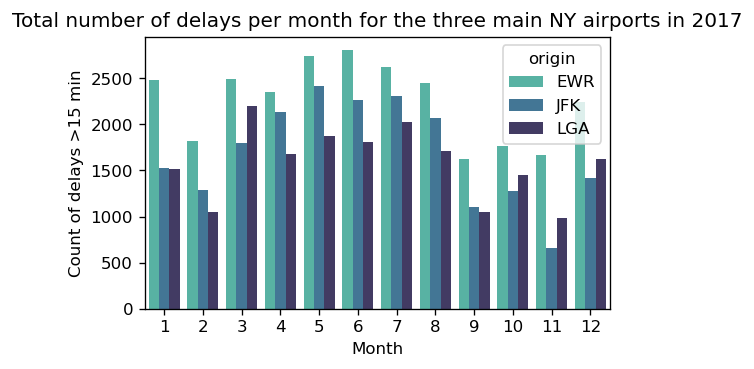

In [132]:
from matplotlib import pyplot as plt
import seaborn as sns

sns.barplot(x = 'month', y = 'dep_delay_true', hue = 'origin', palette = "mako_r", data = delay_by_month)
plt.title("Total number of delays per month for the three main NY airports in 2017")
plt.xlabel("Month")
plt.ylabel("Count of delays >15 min");

#normalise to total number of flights per month


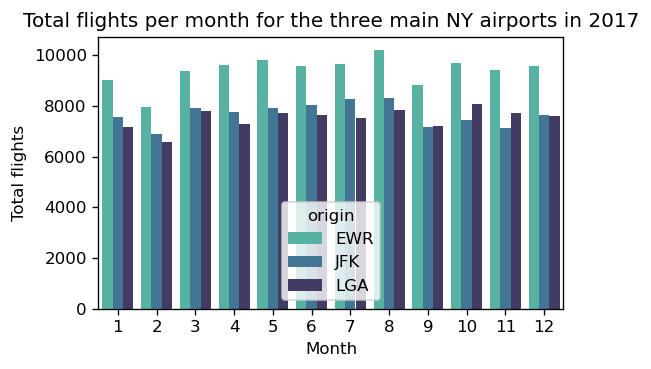

In [141]:
sns.barplot(x = 'month', y = 'day', hue = 'origin', palette = "mako_r", data = total_flights_by_month)
plt.title("Total flights per month for the three main NY airports in 2017")
plt.xlabel("Month")
plt.ylabel("Total flights");